I used VCFtools on the command line to calucalte FST values from the VCF files supplied to me using the below example call: 
vcftools --gzvcf vcf/chr3_460_540_phased.vcf.gz    --weir-fst-pop txt/ESN_inds.txt  --weir-fst-pop txt/YRI_inds.txt --out output/ESN-YRI

I saved the outputed files (a log file and a .windowed.weir.fst file) to the directory /tessdiv/FinalProjectPopGenome/output. 
Note that i need to invesitigate the step size and/or justify it in my report. Likely will require info from Jarvis et al. 


A. Perform an Fst scan between sets of populations in a sliding window of 100 SNP positions, comparing at least five pairs of populations. 
Identify the Fst outlier regions in each case.

In [26]:
library(ggplot2)
library(dplyr)
library(vcfR)
library(plotly)


Read in tables and remove NA values 

In [3]:
ESN_GWD <- read.table("output/ESN_GWD.weir.fst", header=TRUE)
ESN_GWD <- na.omit(ESN_GWD)


In [4]:
ESN_LWK <- read.table("output/ESN_LWK.weir.fst", header=TRUE)
ESN_LWK <- na.omit(ESN_LWK)

In [5]:
ESN_MSL <- read.table("output/ESN_MSL.weir.fst", header=TRUE)
ESN_MSL <- na.omit(ESN_MSL)

In [6]:
ESN_YRI <- read.table("output/ESN_YRI.weir.fst", header=TRUE)
ESN_YRI <- na.omit(ESN_YRI)

In [7]:
GWD_LWK <- read.table("output/GWD_LWK.weir.fst", header=TRUE)
GWD_LWK <- na.omit(GWD_LWK)

In [8]:
GWD_MSL <- read.table("output/GWD_MSL.weir.fst", header=TRUE)
GWD_MSL <- na.omit(GWD_MSL)

In [9]:
GWD_YRI <- read.table("output/GWD_YRI.weir.fst", header=TRUE)
GWD_YRI <- na.omit(GWD_YRI)

In [10]:
LWK_MSL <- read.table("output/LWK_MSL.weir.fst", header=TRUE)
LWK_MSL <- na.omit(LWK_MSL)

In [11]:
LWK_YRI <- read.table("output/LWK_YRI.weir.fst", header=TRUE)
LWK_YRI <- na.omit(LWK_YRI)

In [12]:
MSL_YRI <- read.table("output/MSL_YRI.weir.fst", header=TRUE)
MSL_YRI <- na.omit(MSL_YRI)

Now all of the fst values have been read in to R and the na values have been removed so I can perform a scan in a sliding window of 100 SNP positons and identify the outlier regions 

slide_windows- function for calculating fst values using 
variable sliding window and step size from file with fst values already calculated

In [13]:
slide_windows <- function(fst_data, window_size, step_size){
    n_sites <- nrow(fst_data)
    n_windows <- floor((n_sites - window_size)/step_size)+1
    
    window_start <- seq(1, n_sites - window_size+1, by=step_size)
    window_end <- window_start + window_size - 1
    
    fst_window <- data.frame(matrix(ncol = 4, nrow = n_windows))
    colnames(fst_window) <- c("CHROM", "WINDOW_START", "WINDOW_END", "MEAN_FST")
    
    for (i in 1:n_windows) {
        fst_window$CHROM[i] <- fst_data$CHROM[window_start[i]]
        fst_window$WINDOW_START[i] <- fst_data$POS[window_start[i]]
        fst_window$WINDOW_END[i] <- fst_data$POS[window_end[i]]
        fst_window$MEAN_FST[i] <- mean(fst_data$WEIR_AND_COCKERHAM_FST[window_start[i]:window_end[i]])
    }
    return(fst_window)
}


In [14]:
window_size <- 100 
window_step <- 10

In [15]:
ESN_GWD_fst <- slide_windows(ESN_GWD, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

ESN_LWK_fst <- slide_windows(ESN_LWK, window_size, window_step)  %>% 
mutate(MEAN_FST = ifelse(MEAN_FST <0,0, MEAN_FST))

ESN_MSL_fst <- slide_windows(ESN_MSL, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

ESN_YRI_fst <- slide_windows(ESN_GWD, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))


GWD_LWK_fst <- slide_windows(GWD_LWK, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

GWD_MSL_fst <- slide_windows(GWD_MSL, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

GWD_YRI_fst <- slide_windows(GWD_YRI, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

LWK_MSL_fst <- slide_windows(LWK_MSL, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

LWK_YRI_fst <- slide_windows(LWK_YRI, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))

MSL_YRI_fst <- slide_windows(MSL_YRI, window_size, window_step) %>%
mutate(MEAN_FST = ifelse(MEAN_FST < 0, 0, MEAN_FST))


In [16]:
all_Fst <- data.frame(Fst = c(ESN_GWD_fst$MEAN_FST, 
                              ESN_LWK_fst$MEAN_FST,
                              ESN_MSL_fst$MEAN_FST,
                              ESN_YRI_fst$MEAN_FST, 
                              GWD_LWK_fst$MEAN_FST,
                              GWD_MSL_fst$MEAN_FST,
                              GWD_YRI_fst$MEAN_FST,
                              LWK_MSL_fst$MEAN_FST,
                              LWK_YRI_fst$MEAN_FST,
                              MSL_YRI_fst$MEAN_FST)) %>% 
arrange(Fst)



##### threshold <- quantile(all_Fst$Fst, 0.99)
threshold

In [18]:
# The palette with grey:
cbPalette <- c("#999999", "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7")


Warning message:
“Removed 29 rows containing missing values (`geom_point()`).”
Saving 6.67 x 6.67 in image
Warning message:
“Removed 35 rows containing missing values (`geom_point()`).”


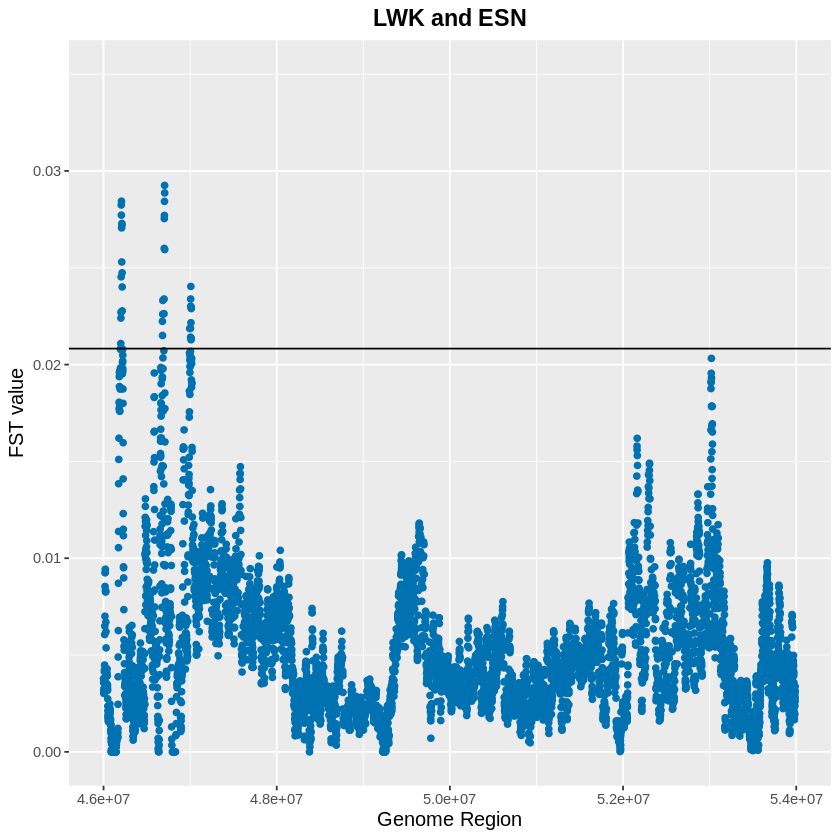

In [19]:
LWK_ESN_plot <- ggplot() + 
geom_jitter(data = ESN_LWK_fst, aes(x=WINDOW_START, y=MEAN_FST), color="#0072B2")+ 
geom_hline(yintercept = threshold) + 
xlim(46000000, 54000000) +
  ylim(0, 0.035) +
labs(x = "Genome Region", y = "FST value", title = "LWK and ESN") +
theme(axis.title = element_text(size = 12),
     plot.title = element_text(size= 14, face = "bold", hjust = 0.5))
LWK_ESN_plot
ggsave("LWK_ESN_plot.png", LWK_ESN_plot)

Warning message:
“Removed 5 rows containing missing values (`geom_point()`).”
Saving 6.67 x 6.67 in image
Warning message:
“Removed 6 rows containing missing values (`geom_point()`).”


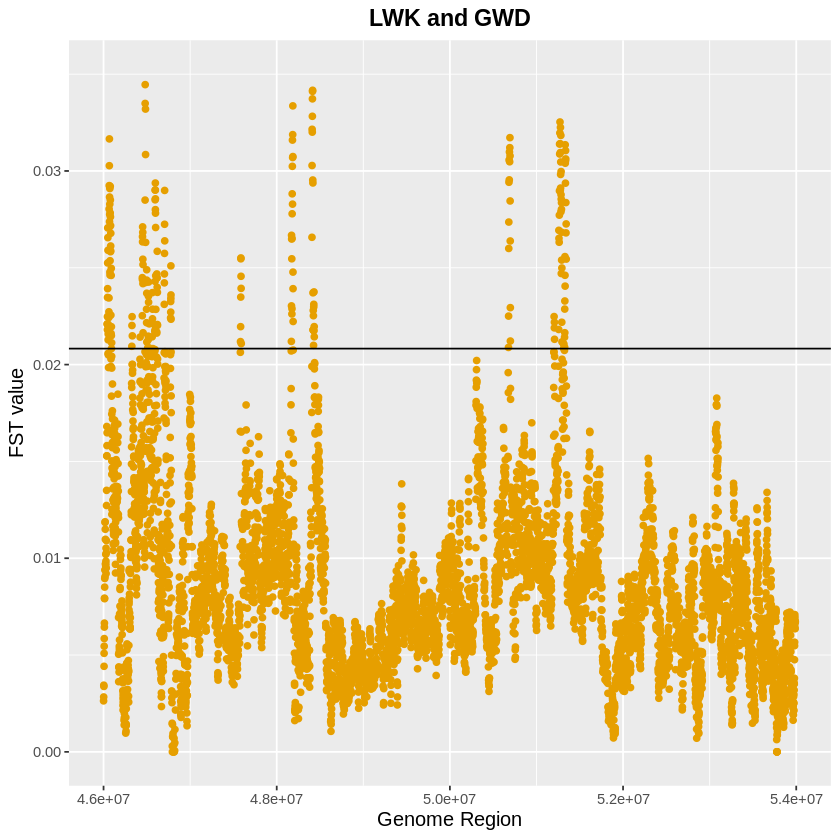

In [20]:
LWK_GWD_plot <- ggplot() + 
geom_jitter(data = GWD_LWK_fst, aes(x=WINDOW_START, y=MEAN_FST), color="#E69F00")+ 
geom_hline(yintercept = threshold)+ 
xlim(46000000, 54000000) +
  ylim(0, 0.035) +
labs(x = "Genome Region", y = "FST value", title = "LWK and GWD") +
theme(axis.title = element_text(size = 12),
     plot.title = element_text(size= 14, face = "bold", hjust = 0.5))
LWK_GWD_plot
ggsave("LWK_GWD_plot.png", LWK_GWD_plot)

Warning message:
“Removed 5 rows containing missing values (`geom_point()`).”
Saving 6.67 x 6.67 in image
Warning message:
“Removed 4 rows containing missing values (`geom_point()`).”


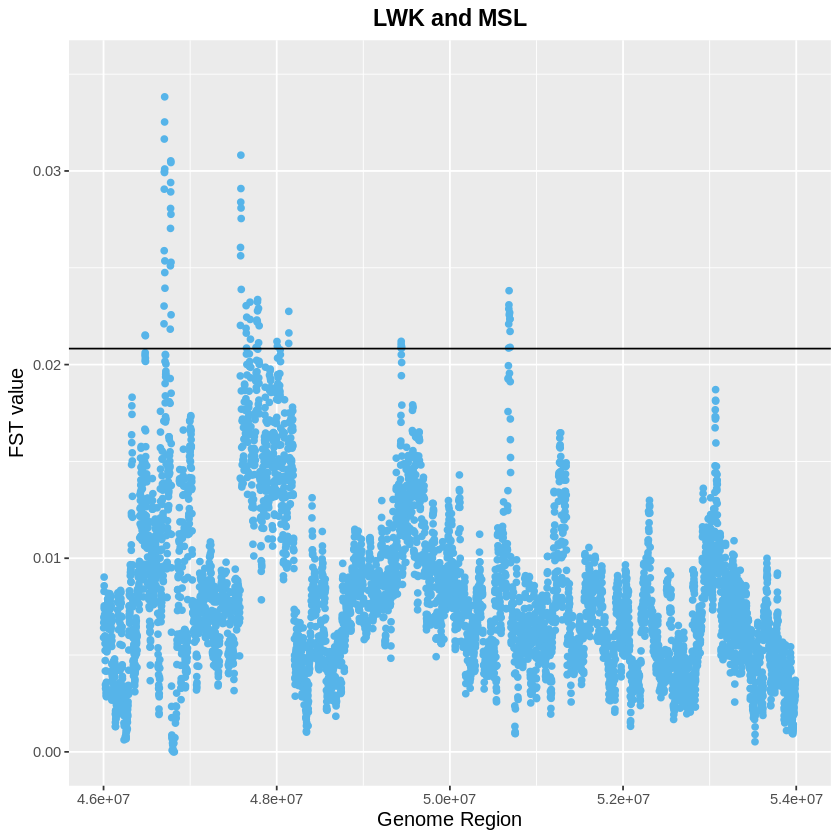

In [21]:
LWK_MSL_plot <- ggplot() + 
geom_jitter(data = LWK_MSL_fst, aes(x=WINDOW_START, y=MEAN_FST), color="#56B4E9")+ 
geom_hline(yintercept = threshold)+ 
xlim(46000000, 54000000) +
  ylim(0, 0.035) +
labs(x = "Genome Region", y = "FST value", title = "LWK and MSL") +
theme(axis.title = element_text(size = 12),
     plot.title = element_text(size= 14, face = "bold", hjust = 0.5))
LWK_MSL_plot
ggsave("LWK_MSL_plot.png", LWK_MSL_plot)

Warning message:
“Removed 14 rows containing missing values (`geom_point()`).”
Saving 6.67 x 6.67 in image
Warning message:
“Removed 13 rows containing missing values (`geom_point()`).”


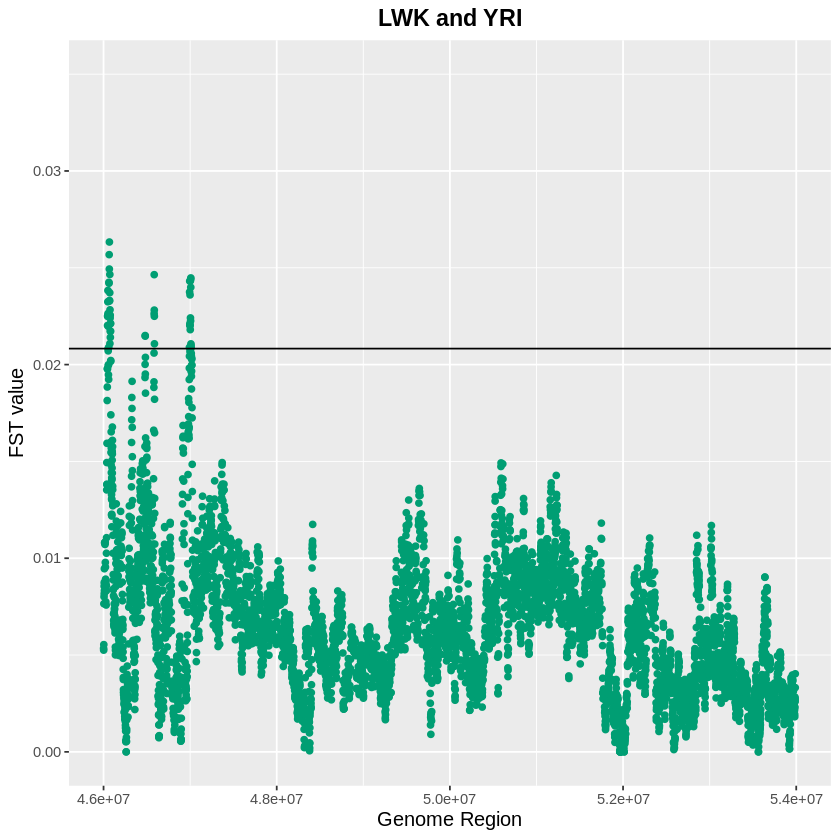

In [22]:
LWK_YRI_plot <- ggplot() + 
geom_jitter(data = LWK_YRI_fst, aes(x=WINDOW_START, y=MEAN_FST), color="#009E73")+ 
geom_hline(yintercept = threshold)+ 
xlim(46000000, 54000000) +
  ylim(0, 0.035) +
labs(x = "Genome Region", y = "FST value", title = "LWK and YRI") +
theme(axis.title = element_text(size = 12),
     plot.title = element_text(size= 14, face = "bold", hjust = 0.5))
LWK_YRI_plot
ggsave("LWK_YRI_plot.png", LWK_YRI_plot)

Warning message:
“Removed 12 rows containing missing values (`geom_point()`).”
Saving 6.67 x 6.67 in image
Warning message:
“Removed 17 rows containing missing values (`geom_point()`).”


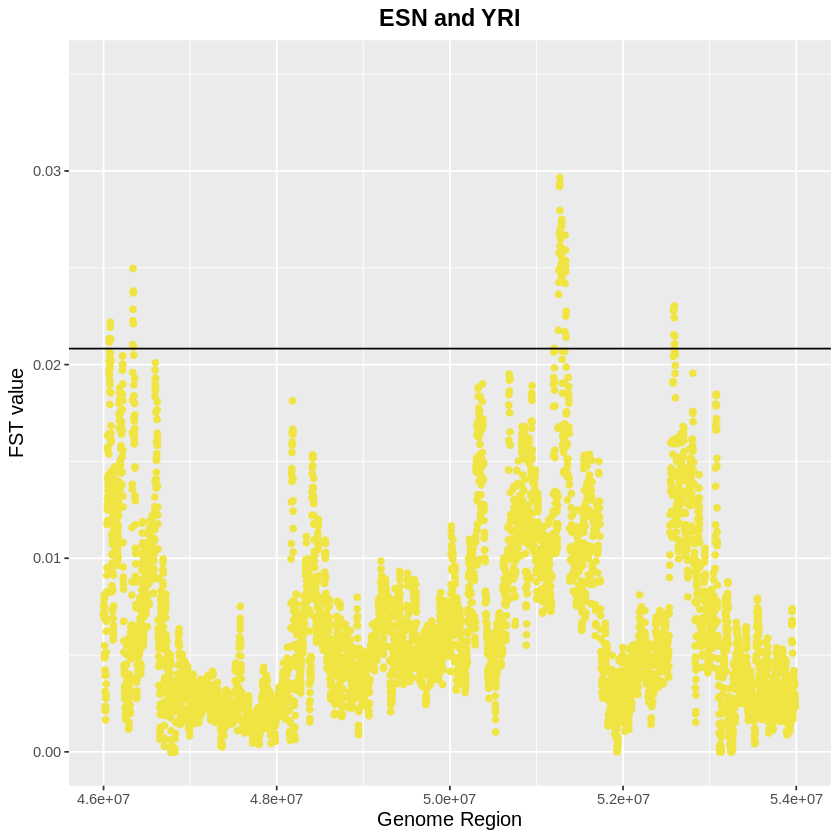

In [23]:
ESN_YRI_plot <- ggplot() + 
geom_jitter(data = ESN_YRI_fst, aes(x=WINDOW_START, y=MEAN_FST), color="#F0E442")+ 
geom_hline(yintercept = threshold)+ 
xlim(46000000, 54000000) +
  ylim(0, 0.035) +
labs(x = "Genome Region", y = "FST value", title = "ESN and YRI") +
theme(axis.title = element_text(size = 12),
     plot.title = element_text(size= 14, face = "bold", hjust = 0.5))
ESN_YRI_plot
ggsave("ESN_YRI_plot.png", ESN_YRI_plot)

LOOOOSELY done with Part A 

Need to specifically ID regions of interest. 

In [28]:
ggplotly(LWK_ESN_plot)
ggplotly(LWK_GWD_plot)
ggplotly(LWK_MSL_plot)
ggplotly(LWK_YRI_plot)
ggplotly(ESN_YRI_plot)


HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)